In [1]:
import numpy as np 
import pandas as pd 
from matplotlib import pyplot as plt
import seaborn as sns
import lightgbm as lgb
import warnings

warnings.filterwarnings('ignore')

In [2]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', 20)
pd.set_option('display.width', 500)
pd.set_option('display.expand_frame_repr', False)

Reading the data

In [48]:
df = pd.read_csv('merged_df.csv', parse_dates=['date'], index_col=0)

In [14]:
df.isna().sum()

item_id                0
store_id               0
date_id                0
cnt                    0
date                   0
wm_yr_wk               0
wday                   0
month                  0
year                   0
event_name_1           0
event_type_1           0
event_name_2           0
event_type_2           0
cashback_store_1       0
cashback_store_2       0
cashback_store_3       0
sell_price          3913
dtype: int64

Data Analysis

In [15]:
df.shape

(81855, 17)

In [16]:
df.head()

,item_id,store_id,date_id,cnt,date,wm_yr_wk,wday,month,year,event_name_1,event_type_1,event_name_2,event_type_2,cashback_store_1,cashback_store_2,cashback_store_3,sell_price
30,STORE_1_064,STORE_1,1.0,0.0,2011-01-29,11101,1,1,2011,Unknown,Unknown,Unknown,Unknown,0.0,0.0,0.0,2.54
75,STORE_1_064,STORE_1,2.0,1.0,2011-01-30,11101,2,1,2011,Unknown,Unknown,Unknown,Unknown,0.0,0.0,0.0,2.54
120,STORE_1_064,STORE_1,3.0,0.0,2011-01-31,11101,3,1,2011,Unknown,Unknown,Unknown,Unknown,0.0,0.0,0.0,2.54
165,STORE_1_064,STORE_1,4.0,0.0,2011-02-01,11101,4,2,2011,Unknown,Unknown,Unknown,Unknown,0.0,1.0,1.0,2.54
210,STORE_1_064,STORE_1,5.0,0.0,2011-02-02,11101,5,2,2011,Unknown,Unknown,Unknown,Unknown,1.0,1.0,0.0,2.54


In [17]:
df.tail()

,item_id,store_id,date_id,cnt,date,wm_yr_wk,wday,month,year,event_name_1,event_type_1,event_name_2,event_type_2,cashback_store_1,cashback_store_2,cashback_store_3,sell_price
81659,STORE_3_804,STORE_3,1815.0,21.0,2016-01-17,11551,2,1,2016,Unknown,Unknown,Unknown,Unknown,0.0,0.0,0.0,1.88
81704,STORE_3_804,STORE_3,1816.0,28.0,2016-01-18,11551,3,1,2016,MartinLutherKingDay,National,Unknown,Unknown,0.0,0.0,0.0,1.88
81749,STORE_3_804,STORE_3,1817.0,5.0,2016-01-19,11551,4,1,2016,Unknown,Unknown,Unknown,Unknown,0.0,0.0,0.0,1.88
81794,STORE_3_804,STORE_3,1818.0,8.0,2016-01-20,11551,5,1,2016,Unknown,Unknown,Unknown,Unknown,0.0,0.0,0.0,1.88
81839,STORE_3_804,STORE_3,1819.0,17.0,2016-01-21,11551,6,1,2016,Unknown,Unknown,Unknown,Unknown,0.0,0.0,0.0,1.88


In [18]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 81855 entries, 30 to 81839
Data columns (total 17 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   item_id           81855 non-null  object        
 1   store_id          81855 non-null  object        
 2   date_id           81855 non-null  float64       
 3   cnt               81855 non-null  float64       
 4   date              81855 non-null  datetime64[ns]
 5   wm_yr_wk          81855 non-null  int64         
 6   wday              81855 non-null  int64         
 7   month             81855 non-null  int64         
 8   year              81855 non-null  int64         
 9   event_name_1      81855 non-null  object        
 10  event_type_1      81855 non-null  object        
 11  event_name_2      81855 non-null  object        
 12  event_type_2      81855 non-null  object        
 13  cashback_store_1  81855 non-null  float64       
 14  cashback_store_2  818

In [19]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
date_id,81855.0,910.000000,525.103198,1.0,455.00,910.00,1365.00,1819.00
cnt,81855.0,23.201405,36.935855,0.0,1.00,9.00,32.00,763.00
wm_yr_wk,81855.0,11325.610775,141.474846,11101.0,11213.00,11326.00,11438.00,11551.00
wday,81855.0,3.998351,1.999324,1.0,2.00,4.00,6.00,7.00
month,81855.0,6.544805,3.438085,1.0,4.00,7.00,10.00,12.00
year,81855.0,2013.064871,1.430138,2011.0,2012.00,2013.00,2014.00,2016.00
cashback_store_1,81855.0,0.329852,0.470162,0.0,0.00,0.00,1.00,1.00
cashback_store_2,81855.0,0.329852,0.470162,0.0,0.00,0.00,1.00,1.00
cashback_store_3,81855.0,0.329852,0.470162,0.0,0.00,0.00,1.00,1.00
sell_price,77942.0,2.005399,1.211045,0.2,1.28,1.58,2.54,6.71


In [20]:
df.isnull().sum()

item_id                0
store_id               0
date_id                0
cnt                    0
date                   0
wm_yr_wk               0
wday                   0
month                  0
year                   0
event_name_1           0
event_type_1           0
event_name_2           0
event_type_2           0
cashback_store_1       0
cashback_store_2       0
cashback_store_3       0
sell_price          3913
dtype: int64

In [21]:
df["date"].min(), df["date"].max()

(Timestamp('2011-01-29 00:00:00'), Timestamp('2016-01-21 00:00:00'))

In [22]:
df.groupby(["store_id", "item_id"]).agg({"cnt": ["sum", "mean", "median", "std"], "sell_price": ["sum", "mean", "median", "std"]})

cnt                               sell_price                           
                           sum        mean median        std        sum      mean median       std
store_id item_id                                                                                  
STORE_1  STORE_1_064     610.0    0.335349    0.0   0.681129    4749.48  2.611039   2.68  0.070012
         STORE_1_065     531.0    0.291919    0.0   0.650798    5974.32  3.284398   3.28  0.209768
         STORE_1_090  113668.0   62.489280   58.0  55.719548    2422.09  1.331550   1.38  0.097595
         STORE_1_252   35640.0   19.593183   17.0  11.454530    2756.42  1.515349   1.48  0.047818
         STORE_1_325   12939.0    7.113249    6.0   6.388102    1911.08  1.172442   1.14  0.064864
...                        ...         ...    ...        ...        ...       ...    ...       ...
STORE_3  STORE_3_555   93163.0   51.216603   48.0  19.033678    2890.02  1.588796   1.58  0.070980
         STORE_3_586  184899.0  101.648708   98.0  31.094470    2890.02  1.588796   1.58  0.070980
         STORE_3_587   47244.0   25.972512   26.0  17.085410    4340.32  2.386102   2.48  0.353404
         STORE_3_714   43531.0   23.931281   22.0  12.917109    2764.12  1.519582   1.48  0.048916
         STORE_3_804   22788.0   12.527763   11.0   7.835259    3419.72  1.880000   1.88  0.000000

[45 rows x 8 columns]

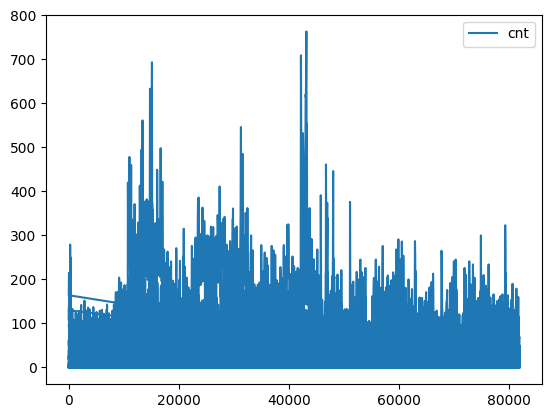

In [23]:
df[["cnt"]].plot()
plt.show(block=True)

Feature Engineering

In [265]:
df['quarter_of_year'] = df.date.dt.quarter
df['week_of_year'] = df.date.dt.weekofyear
df['day_of_year'] = df.date.dt.dayofyear
df['day_of_month'] = df.date.dt.day
df['day_of_week'] = df.date.dt.dayofweek
df["is_wknd"] = df.date.dt.weekday // 4
df['is_month_start'] = df.date.dt.is_month_start.astype(int)
df['is_month_end'] = df.date.dt.is_month_end.astype(int)

Random Noise

In [53]:
def random_noise(dataframe):
    return np.random.normal(scale=1.5, size=(len(dataframe),))

Lag/Shifted Features

In [50]:
df.sort_values(by=['store_id', 'item_id', 'date'], axis=0, inplace=True)

In [51]:
pd.DataFrame({"cnt": df["cnt"].values[0:10],
              "lag1": df["cnt"].shift(1).values[0:10],
              "lag2": df["cnt"].shift(2).values[0:10],
              "lag3": df["cnt"].shift(3).values[0:10],
              "lag4": df["cnt"].shift(4).values[0:10]})

,cnt,lag1,lag2,lag3,lag4
0,0.0,NaN,NaN,NaN,NaN
1,1.0,0.0,NaN,NaN,NaN
2,0.0,1.0,0.0,NaN,NaN
3,0.0,0.0,1.0,0.0,NaN
4,0.0,0.0,0.0,1.0,0.0
5,0.0,0.0,0.0,0.0,1.0
6,2.0,0.0,0.0,0.0,0.0
7,0.0,2.0,0.0,0.0,0.0
8,1.0,0.0,2.0,0.0,0.0
9,0.0,1.0,0.0,2.0,0.0


In [52]:
df.groupby(["store_id", "item_id"])['cnt'].transform(lambda x: x.shift(1))

30        NaN
75        0.0
120       1.0
165       0.0
210       0.0
         ... 
81659    11.0
81704    21.0
81749    28.0
81794     5.0
81839     8.0
Name: cnt, Length: 81855, dtype: float64

In [54]:
def lag_features(dataframe, lags):
    for lag in lags:
        dataframe['cnt_lag_' + str(lag)] = dataframe.groupby(["store_id", "item_id"])['cnt'].transform(
            lambda x: x.shift(lag)) + random_noise(dataframe)
    return dataframe

In [73]:
df.item_id.unique()

array(['STORE_1_064', 'STORE_1_065', 'STORE_1_090', 'STORE_1_252',
       'STORE_1_325', 'STORE_1_339', 'STORE_1_376', 'STORE_1_546',
       'STORE_1_547', 'STORE_1_555', 'STORE_1_584', 'STORE_1_586',
       'STORE_1_587', 'STORE_1_714', 'STORE_1_727', 'STORE_2_043',
       'STORE_2_054', 'STORE_2_085', 'STORE_2_090', 'STORE_2_252',
       'STORE_2_325', 'STORE_2_376', 'STORE_2_391', 'STORE_2_524',
       'STORE_2_555', 'STORE_2_586', 'STORE_2_587', 'STORE_2_681',
       'STORE_2_714', 'STORE_2_716', 'STORE_3_012', 'STORE_3_090',
       'STORE_3_114', 'STORE_3_169', 'STORE_3_222', 'STORE_3_252',
       'STORE_3_357', 'STORE_3_358', 'STORE_3_360', 'STORE_3_389',
       'STORE_3_555', 'STORE_3_586', 'STORE_3_587', 'STORE_3_714',
       'STORE_3_804'], dtype=object)

In [79]:
def extract_SKU_df(data, SKU_ID_column, SKU_ID):
    return data[data[SKU_ID_column] == SKU_ID]

<Figure size 1000x600 with 0 Axes>

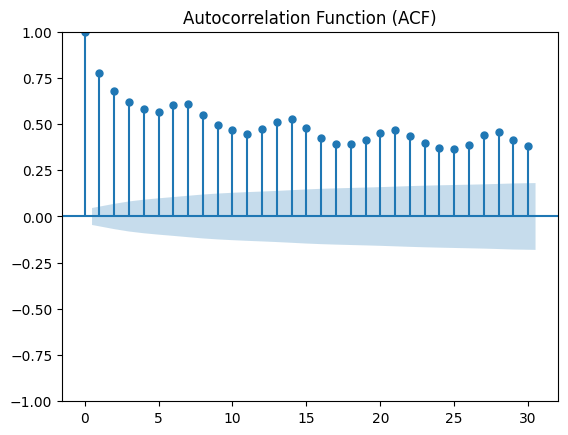

In [123]:
from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.tsa.stattools import acf
plt.figure(figsize=(10, 6))
plot_acf(extract_SKU_df(df, 'item_id', "STORE_1_587").cnt, lags=30)
plt.title("Autocorrelation Function (ACF)")
plt.show()

In [124]:
df = lag_features(df, [1, 2, 6, 7, 13, 14, 91, 122])

Rolling Mean Features

In [126]:
pd.DataFrame({"cnt": df["cnt"].values[0:10],
              "roll2": df["cnt"].shift(1).rolling(window=2).mean().values[0:10],
              "roll3": df["cnt"].shift(1).rolling(window=3).mean().values[0:10],
              "roll5": df["cnt"].shift(1).rolling(window=5).mean().values[0:10]})

,cnt,roll2,roll3,roll5
0,0.0,NaN,NaN,NaN
1,1.0,NaN,NaN,NaN
2,0.0,0.5,NaN,NaN
3,0.0,0.5,0.333333,NaN
4,0.0,0.0,0.333333,NaN
5,0.0,0.0,0.000000,0.2
6,2.0,0.0,0.000000,0.2
7,0.0,1.0,0.666667,0.4
8,1.0,1.0,0.666667,0.4
9,0.0,0.5,1.000000,0.6


In [130]:
def roll_mean_features(dataframe, windows):
    for window in windows:
        dataframe['cnt_roll_mean_' + str(window)] = dataframe.groupby(["store_id", "item_id"])['cnt']. \
                                                          transform(
            lambda x: x.shift(1).rolling(window=window, min_periods=10, win_type="triang").mean()) + random_noise(
            dataframe)
    return dataframe

In [136]:
df = roll_mean_features(df, [30, 91, 365, 546])

Exponentially Weighted Mean Features

In [137]:
pd.DataFrame({"cnt": df["cnt"].values[0:10],
              "roll2": df["cnt"].shift(1).rolling(window=2).mean().values[0:10],
              "ewm099": df["cnt"].shift(1).ewm(alpha=0.99).mean().values[0:10],
              "ewm095": df["cnt"].shift(1).ewm(alpha=0.95).mean().values[0:10],
              "ewm07": df["cnt"].shift(1).ewm(alpha=0.7).mean().values[0:10],
              "ewm02": df["cnt"].shift(1).ewm(alpha=0.1).mean().values[0:10]})

,cnt,roll2,ewm099,ewm095,ewm07,ewm02
0,0.0,NaN,NaN,NaN,NaN,NaN
1,1.0,NaN,0.000000e+00,0.000000,0.000000,0.000000
2,0.0,0.5,9.900990e-01,0.952381,0.769231,0.526316
3,0.0,0.5,9.900010e-03,0.047506,0.215827,0.332103
4,0.0,0.0,9.900000e-05,0.002375,0.063514,0.235534
5,0.0,0.0,9.900000e-07,0.000119,0.018946,0.178018
6,2.0,0.0,9.900000e-09,0.000006,0.005674,0.140025
7,0.0,1.0,1.980000e+00,1.900000,1.402008,0.496545
8,1.0,1.0,1.980000e-02,0.095000,0.420538,0.409360
9,0.0,0.5,9.901980e-01,0.954750,0.826169,0.505779


In [138]:
def ewm_features(dataframe, alphas, lags):
    for alpha in alphas:
        for lag in lags:
            dataframe['cnt_ewm_alpha_' + str(alpha).replace(".", "") + "_lag_" + str(lag)] = \
                dataframe.groupby(["store_id", "item_id"])['cnt'].transform(lambda x: x.shift(lag).ewm(alpha=alpha).mean())
    return dataframe

In [140]:
alphas = [0.95, 0.9, 0.8, 0.7, 0.5]
lags = [91, 98, 105, 112, 180, 270, 365]

In [141]:
df = ewm_features(df, alphas, lags)

In [145]:
df.item_id.unique()

array(['STORE_1_064', 'STORE_1_065', 'STORE_1_090', 'STORE_1_252',
       'STORE_1_325', 'STORE_1_339', 'STORE_1_376', 'STORE_1_546',
       'STORE_1_547', 'STORE_1_555', 'STORE_1_584', 'STORE_1_586',
       'STORE_1_587', 'STORE_1_714', 'STORE_1_727', 'STORE_2_043',
       'STORE_2_054', 'STORE_2_085', 'STORE_2_090', 'STORE_2_252',
       'STORE_2_325', 'STORE_2_376', 'STORE_2_391', 'STORE_2_524',
       'STORE_2_555', 'STORE_2_586', 'STORE_2_587', 'STORE_2_681',
       'STORE_2_714', 'STORE_2_716', 'STORE_3_012', 'STORE_3_090',
       'STORE_3_114', 'STORE_3_169', 'STORE_3_222', 'STORE_3_252',
       'STORE_3_357', 'STORE_3_358', 'STORE_3_360', 'STORE_3_389',
       'STORE_3_555', 'STORE_3_586', 'STORE_3_587', 'STORE_3_714',
       'STORE_3_804'], dtype=object)

In [204]:
df_item = extract_SKU_df(df, "item_id", 'STORE_1_064')

In [205]:
df_item.drop(columns = ['item_id', 'store_id', 'date_id', 'date'], inplace=True)

One-Hot Encoding

In [206]:
df_item = pd.get_dummies(df_item, columns=['event_name_1', 'event_type_1', 'event_name_2', 'event_type_2'])

Model

In [185]:
# def smape(targets, forecast):
#     return 100/len(targets) * np.sum(2 * np.abs(forecast - targets) / (np.abs(targets) + np.abs(forecast)))


# def lgbm_smape(preds, train_data):
#     labels = train_data.get_label()
#     smape_val = smape(preds, labels)
#     return 'SMAPE', smape_val, False

In [317]:
### CREATE X,Y ####
def create_xy(series, window_size, prediction_horizon, shuffle = False):
    x = []
    y = []
    y_series = series.cnt
    for i in range(0, len(series)):
        if len(series[(i + window_size):(i + window_size + prediction_horizon)]) < prediction_horizon:
            break
        x.append(series[i:(i + window_size)])
        y.append(y_series[(i + window_size):(i + window_size + prediction_horizon)])
    x = np.array(x)
    y = np.array(y)
    return x,y

cnt_data = df_item.cnt

In [363]:
### HYPERPARAMETERS ###
window_size = 365
prediction_horizon = 1

### TRAIN VAL SPLIT ### 
test_size = 28
split_time = len(cnt_data) - test_size

train_series = cnt_data[:split_time]
test_series = cnt_data[split_time - window_size:]

train_x, train_y = create_xy(train_series, window_size, prediction_horizon)
test_x, test_y = create_xy(test_series, window_size, prediction_horizon)

train_y = train_y.flatten()
test_y = test_y.flatten()
train_x = train_x.reshape(train_x.shape[0], -1)
test_x = test_x.reshape(test_x.shape[0], -1)

print(train_x.shape)
print(train_y.shape)
print(test_x.shape)
print(test_y.shape)

(1426, 39420)
(1426,)
(28, 39420)
(28,)


AttributeError: 'Series' object has no attribute 'cnt'

In [368]:
df_item.to_csv('one_SKU.csv')

In [366]:
from sklearn.metrics import mean_squared_error
params = {
    'n_estimators': 2000,
    'max_depth': 4,
    'num_leaves': 2**4,
    'learning_rate': 0.1,
    'boosting_type': 'dart',
    'num_boost_round': 10000,
}

model = lgb.LGBMRegressor(first_metric_only = True, **params)

train_data = lgb.Dataset(train_x, label=train_y)
model = lgb.train(params, train_data, num_boost_round=100)
forecast = model.predict(test_x)
forecast[forecast < 0] = 0

mean_squared_error(test_y, forecast)

KeyboardInterrupt: 

     Naive MAE: 0.2857
  s7-Naive MAE: 0.1786
 s30-Naive MAE: 0.3571
s365-Naive MAE: 0.5357
  LightGBM MAE: 0.3436


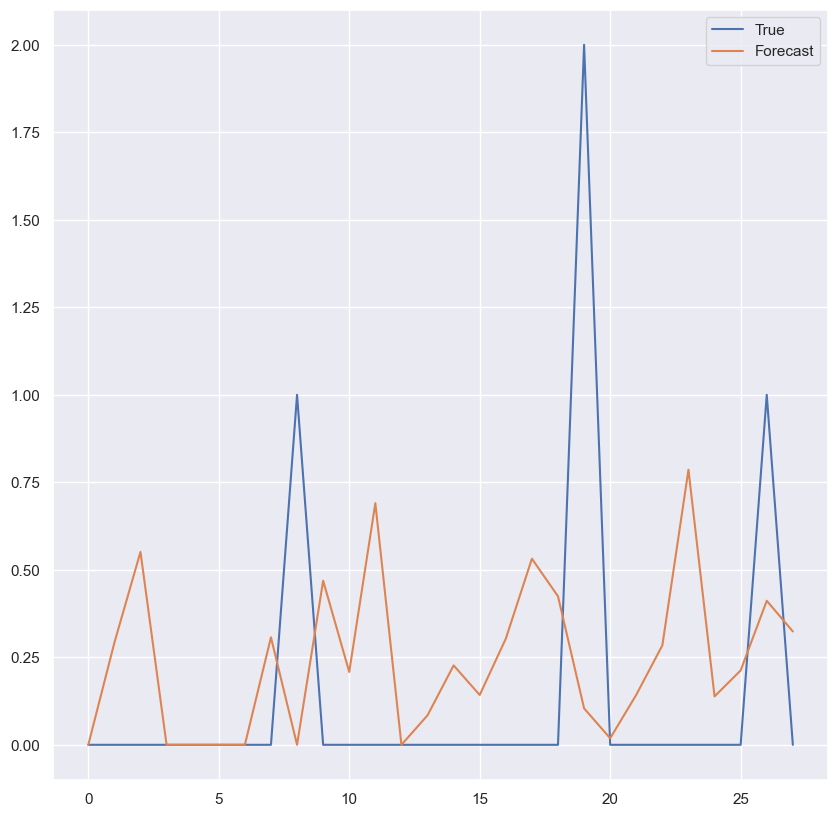

In [362]:
s1_naive = cnt_data[-29:-1].reset_index(drop=True).to_numpy()
s7_naive = cnt_data[-35:-7].reset_index(drop=True).to_numpy()
s30_naive = cnt_data[-56:-28].reset_index(drop=True).to_numpy()
s365_naive = cnt_data[-364:-336].reset_index(drop=True).to_numpy()

print('     Naive MAE: %.4f' % (np.mean(np.abs(s1_naive - test_y))))
print('  s7-Naive MAE: %.4f' % (np.mean(np.abs(s7_naive - test_y))))
print(' s30-Naive MAE: %.4f' % (np.mean(np.abs(s30_naive - test_y))))
print('s365-Naive MAE: %.4f' % (np.mean(np.abs(s365_naive - test_y))))
print('  LightGBM MAE: %.4f' % (np.mean(np.abs(forecast - test_y))))

plt.rcParams['figure.figsize'] = [10,10]

cnt_data[-test_size:].reset_index(drop=True).plot(label = 'True')
plt.plot(forecast, label = 'Forecast')
plt.legend()
plt.show()

In [ ]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold

params = {
    'n_estimators': 2000,
    'max_depth': 4,
    'num_leaves': 2**4,
    'learning_rate': 0.1,
    'boosting_type': 'dart'
}

windows = [7, 30, 180, 365, 545, 730]

results = []
names = []
for w in windows:

    window_size = w

    train_x, train_y = create_xy(train_series, window_size, prediction_horizon)

    train_y = train_y.flatten()

    cv = RepeatedKFold(n_splits = 10, n_repeats = 3, random_state = 123)
    scores = cross_val_score(lgb.LGBMRegressor(**params), train_x, train_y, scoring = 'neg_mean_absolute_error', cv = cv, n_jobs = -1)
    results.append(scores)
    names.append(w)
    print('%3d --- MAE: %.3f (%.3f)' % (w, np.mean(scores), np.std(scores)))

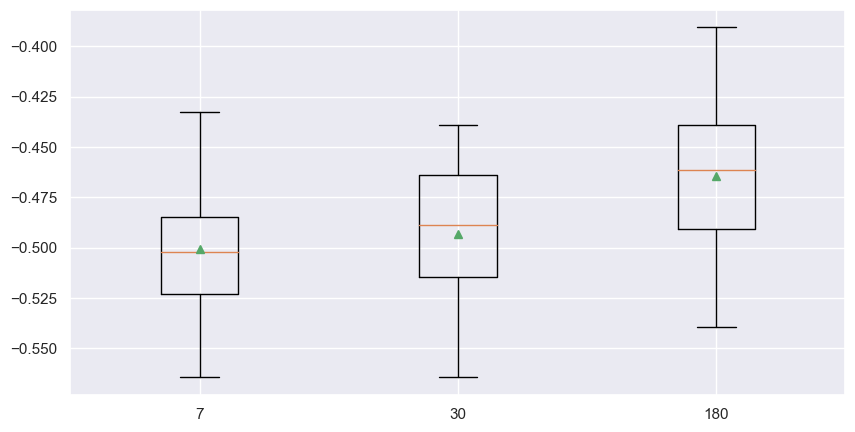

In [329]:
plt.rcParams['figure.figsize'] = [10, 5]    
    
plt.boxplot(results, labels = names, showmeans = True)
plt.show()

[LightGBM] [Warning] There are no meaningful features which satisfy the provided configuration. Decreasing Dataset parameters min_data_in_bin or min_data_in_leaf and re-constructing Dataset might resolve this warning.
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Total Bins 0
[LightGBM] [Info] Number of data points in the train set: 3, number of used features: 0
[LightGBM] [Info] Start training from score 0.333333
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM] [Warning] Stopped training because there are no more leaves that meet the split requirements
[LightGBM]

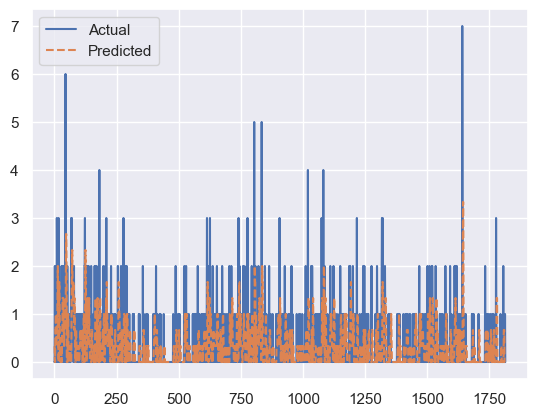

In [215]:
window_size = 3  # 30 previous values to predict the next
forecast_horizon = 1  # Predict 1 step ahead
n_points = len(y)


predictions = []
for i in range(window_size, n_points - forecast_horizon):
    X_train = X.iloc[i - window_size:i, :]
    y_train = y.iloc[i - window_size:i]

    X_test = X.iloc[i:i + forecast_horizon, :]

    train_data = lgb.Dataset(X_train, label=y_train)
    model = lgb.train(params, train_data, num_boost_round=100)
    y_pred = model.predict(X_test)
    
    predictions.append(y_pred[0])

y_actual = y[window_size + forecast_horizon:].reset_index(drop=True)
y_pred = pd.Series(predictions)

rmse = np.sqrt(mean_squared_error(y_actual.shift(3)[:100], y_pred))
print(f'RMSE: {rmse}')

plt.plot(y_actual, label='Actual')
plt.plot(y_pred, label='Predicted', linestyle='--')
plt.legend()
plt.show()

Time Series Model with LightGBM

In [179]:
lgb_params = {'num_leaves': 10,
              'learning_rate': 0.02,
              'feature_fraction': 0.8,
              'max_depth': 5,
              'verbose': 0,
              'num_boost_round': 100,
              'early_stopping_rounds': 5,
              'nthread': -1}

In [174]:
lgbtrain = lgb.Dataset(data=X_train, label=Y_train, feature_name=cols)

lgbval = lgb.Dataset(data=X_val, label=Y_val, reference=lgbtrain, feature_name=cols)

In [180]:
model = lgb.train(lgb_params, lgbtrain,
                  valid_sets=[lgbtrain, lgbval],
                  num_boost_round=lgb_params['num_boost_round'],
                #   early_stopping_rounds=lgb_params['early_stopping_rounds'],
                  feval=lgbm_smape,
                #   verbose_eval=100)
)

In [181]:
y_pred_val = model.predict(X_val, num_iteration=model.best_iteration)

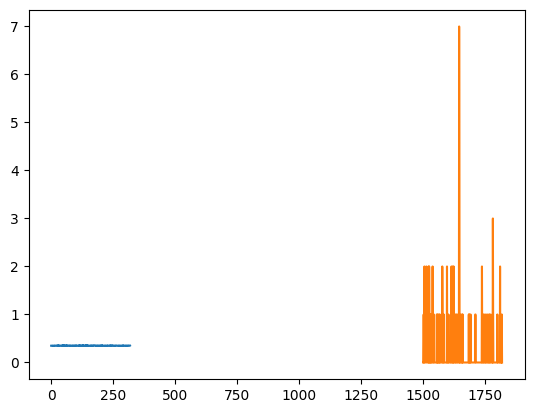

In [189]:
plt.plot(y_pred_val)
plt.plot(Y_val)

In [184]:
smape(Y_val, y_pred_val)

182.15448012048432

In [338]:
def plot_lgb_importances(model, plot=False, num=10):
    gain = model.feature_importance('gain')
    feat_imp = pd.DataFrame({'feature': model.feature_name(),
                             'split': model.feature_importance('split'),
                             'gain': 100 * gain / gain.sum()}).sort_values('gain', ascending=False)
    if plot:
        plt.figure(figsize=(10, 10))
        sns.set(font_scale=1)
        sns.barplot(x="gain", y="feature", data=feat_imp[0:25])
        plt.title('feature')
        plt.tight_layout()
        plt.show(block=True)
    else:
        print(feat_imp.head(num))
    return feat_imp

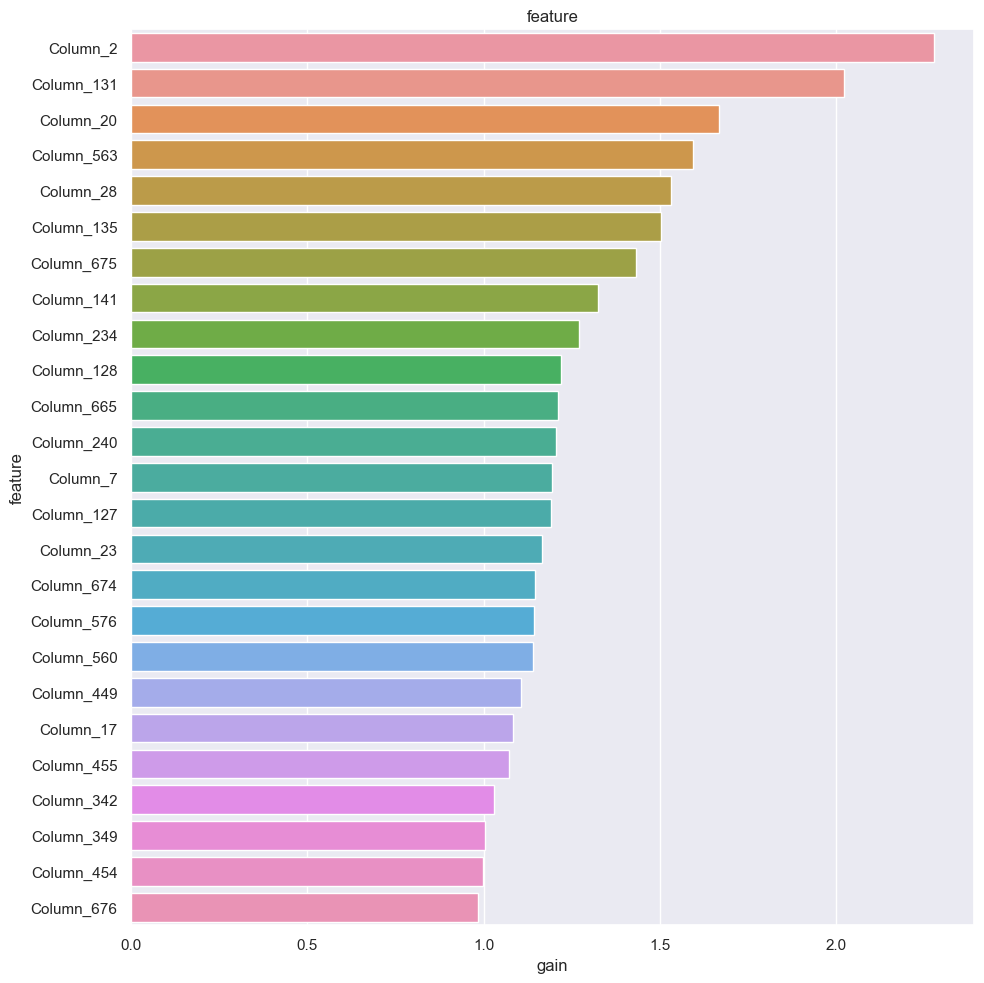

,feature,split,gain
2,Column_2,171,2.275970
131,Column_131,186,2.021020
20,Column_20,85,1.667975
563,Column_563,110,1.594208
28,Column_28,130,1.530732
...,...,...,...
199,Column_199,0,0.000000
200,Column_200,0,0.000000
201,Column_201,0,0.000000
447,Column_447,0,0.000000


In [340]:
plot_lgb_importances(model, num=50, plot=True)

In [38]:
feat_imp = plot_lgb_importances(model, num=200)

low_importance = feat_imp[feat_imp["gain"] <= 0.005]["feature"].values

dff = df.drop(low_importance, axis=1)

cols_dff = [col for col in dff.columns if col not in ['date', 'id', "sales", "year"]]

                        feature  split       gain
18          sales_roll_mean_546   4371  50.797498
14                sales_lag_364   5731  24.018391
61   sales_ewm_alpha_05_lag_365   1332   7.595944
7                  sales_lag_91   1443   2.722237
17          sales_roll_mean_365   4028   1.841733
..                          ...    ...        ...
72                      store_9      8   0.000049
116                     item_43      3   0.000020
79                       item_6      3   0.000014
104                     item_31      1   0.000004
121                     item_48      0   0.000000

[143 rows x 3 columns]


Final Model

In [39]:
train = dff.loc[~df.sales.isna()]
Y_train = train['sales']
X_train = train[cols_dff]


test = dff.loc[df.sales.isna()]
X_test = test[cols_dff]

In [40]:
lgb_params = {'num_leaves': 10,
              'learning_rate': 0.02,
              'feature_fraction': 0.8,
              'max_depth': 5,
              'verbose': 0,
              'nthread': -1,
              "num_boost_round": model.best_iteration}

In [41]:
lgbtrain_all = lgb.Dataset(data=X_train, label=Y_train, feature_name=cols_dff)

In [42]:
final_model = lgb.train(lgb_params, lgbtrain_all, num_boost_round=model.best_iteration)

[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.382721 seconds.
You can set `force_col_wise=true` to remove the overhead.


In [43]:
test_preds = final_model.predict(X_test, num_iteration=model.best_iteration)

In [44]:
submission_df = test.loc[:, ["id", "sales"]]

submission_df['sales'] = test_preds

submission_df['id'] = submission_df.id.astype(int)

In [45]:
submission_df.to_csv("./submission.csv", index=False)